# Imports and KNMI initial code

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import json

In [62]:
# # Load all 12 sheets and combine
# excel_path = r'C:\Users\gr02n\OneDrive\Desktop\KNMI data - Manasa\\four_vs_station.xlsx'
# df = pd.concat(pd.read_excel(excel_path, sheet_name=None), ignore_index=True)

# # Convert date properly
# df['YYYYMMDD'] = pd.to_datetime(df['YYYYMMDD'], format='%Y%m%d', errors='coerce')

# # Convert numeric columns to float
# for col in ['FH', 'T', 'DR', 'RH']:
#     df[col] = pd.to_numeric(df[col], errors='coerce')

# # Group by station and hour
# hourly_avg = df.groupby(['STN', 'HH']).agg({
#     'FH': 'mean',
#     'T': 'mean',
#     'DR': 'mean',
#     'RH': 'mean'
# }).reset_index()

# sns.set(style="whitegrid")

In [63]:
# # Manasa code
# # Wind Speed (FH)
# plt.figure(figsize=(10,6))
# sns.lineplot(data=hourly_avg, x='HH', y='FH', hue='STN', marker='o')
# plt.title('Hourly Variation of Wind Speed (FH) across Stations')
# plt.xlabel('Hour of the Day (1–24)')
# plt.ylabel('Average Wind Speed (0.1 m/s)')
# plt.legend(title='Station', bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.show()

# KNMI

In [2]:
import json

# Files is still not in the branch
path_2023 = r'C:\Users\gr02n\OneDrive\Desktop\KNMI data - Manasa\KNMI-2023.json'
path_2024 = r'C:\Users\gr02n\OneDrive\Desktop\KNMI data - Manasa\KNMI-2024.json'

with open(path_2023, 'r') as file:
    raw_2023 = json.load(file)

with open(path_2024, 'r') as file:
    raw_2024 = json.load(file)

df_2023 = pd.DataFrame(raw_2023)
df_2024 = pd.DataFrame(raw_2024)

# FH    - Hourly average wind speed (in 0.1 m/s)
# T     - Temperature (in 0.1 degrees Celsius) at 1.50 m altitude during the observation
# DR    - Duration of precipitation (in 0.1 hour) per hourly section
# RH    - Hourly Sum of Precipitation (in 0.1 mm) (-1 for <0.05 mm)

df_2023.loc[df_2023["RH"] == -1, "RH"] = 0.05

df_2023['T'] = df_2023['T'] * 0.1   # turn into C
df_2023['RH'] = df_2023['RH'] * 0.1  # turn into mm

df_2023.tail()


,station_code,date,hour,FH,T,DR,RH
39739,391,2023-12-04T00:00:00.000Z,20,50.0,1.8,10.0,1.1
39740,391,2023-12-04T00:00:00.000Z,21,50.0,2.2,10.0,0.8
39741,391,2023-12-04T00:00:00.000Z,22,50.0,2.6,10.0,1.1
39742,391,2023-12-04T00:00:00.000Z,23,40.0,2.9,10.0,0.6
39743,391,2023-12-04T00:00:00.000Z,24,40.0,3.1,8.0,0.1


In [3]:
# Turn 'date' into a datetime object (rather than a string) # '%Y-%m-%dT%H:%M:%S.%fZ'
# df_2023['date'] = pd.to_datetime(df_2023['date'], format= 'mixed')
df_2023['date'] = pd.to_datetime(df_2023['date'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df_2023['day'] = df_2023['date'].dt.day
df_2023['month'] = df_2023['date'].dt.month
df_2023['year'] = df_2023['date'].dt.year

df_2023.head()

,station_code,date,hour,FH,T,DR,RH,day,month,year
0,209,2023-10-30,1,130.0,NaN,NaN,NaN,30,10,2023
1,209,2023-10-30,2,120.0,NaN,NaN,NaN,30,10,2023
2,209,2023-10-30,3,110.0,NaN,NaN,NaN,30,10,2023
3,209,2023-10-30,4,110.0,NaN,NaN,NaN,30,10,2023
4,209,2023-10-30,5,110.0,NaN,NaN,NaN,30,10,2023


In [41]:
# 2023 time period - Nov 6 - Dec 3
# Remove rows from month 11 with day < 6
df_2023 = df_2023[~((df_2023['month'] == 11) & (df_2023['day'] < 6))]

# Remove rows from month 12 with day > 3
df_2023 = df_2023[~((df_2023['month'] == 12) & (df_2023['day'] > 3))]

# Remove all rows from month 10
df_2023 = df_2023[df_2023['month'] != 10]

print(df_2023)

       station_code       date  hour     FH    T    DR     RH  day  month  \
168             209 2023-11-06     1   90.0  NaN   NaN    NaN    6     11   
169             209 2023-11-06     2  100.0  NaN   NaN    NaN    6     11   
170             209 2023-11-06     3  110.0  NaN   NaN    NaN    6     11   
171             209 2023-11-06     4  100.0  NaN   NaN    NaN    6     11   
172             209 2023-11-06     5   90.0  NaN   NaN    NaN    6     11   
...             ...        ...   ...    ...  ...   ...    ...  ...    ...   
39715           391 2023-12-03    20   40.0  0.0  10.0  1.000    3     12   
39716           391 2023-12-03    21   30.0  0.0  10.0  0.700    3     12   
39717           391 2023-12-03    22   30.0 -0.2  10.0  0.100    3     12   
39718           391 2023-12-03    23   30.0 -0.4   0.0  0.005    3     12   
39719           391 2023-12-03    24   30.0 -0.2   0.0  0.000    3     12   

       year  
168    2023  
169    2023  
170    2023  
171    2023  
172  

# Set Station here

In [42]:
df_2023.tail()

station = 344
station_name = 'Delft'

df_2023_station = df_2023[df_2023['station_code'] == station]
df_2023_station.reset_index()

# Assign a unique number to each (day, month) pair
df_2023_station['day_id'] = df_2023_station.groupby(['month', 'day']).ngroup() + 1

# df_2023_station.head()

C:\Users\gr02n\AppData\Local\Temp\ipykernel_15048\979727468.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [43]:
# Group by station and hour
# hourly_avg = df_2023.groupby(['hour']).agg({
#     'FH': 'mean',
#     'T': 'mean',
#     'DR': 'mean',
#     'RH': 'mean'
# }).reset_index()

daily_avr_2023_station = df_2023_station.groupby(['day_id']).agg({
    'FH': 'mean',
    'T': 'mean',
    'DR': 'mean',
    'RH': 'mean'
}).reset_index()

print(daily_avr_2023_station)

# print(df_2023_station)

    day_id         FH          T        DR        RH
0        1  78.333333  10.204167  0.333333  0.030417
1        2  67.916667  10.016667  0.375000  0.155833
2        3  75.416667   9.725000  4.458333  0.692083
3        4  49.166667   9.020833  1.750000  0.287917
4        5  55.416667   7.645833  3.250000  0.938958
5        6  36.250000   8.566667  0.166667  0.067292
6        7  22.916667   5.970833  0.000000  0.000000
7        8  73.750000  11.150000  2.583333  0.270833
8        9  74.583333  12.275000  1.916667  0.462917
9       10  62.500000  11.412500  0.291667  0.064375
10      11  22.083333   7.637500  0.125000  0.013125
11      12  20.416667   6.812500  0.166667  0.008542
12      13  62.916667   9.529167  3.166667  0.446250
13      14  92.500000  12.862500  0.625000  0.037917
14      15  43.333333   9.800000  0.208333  0.037708
15      16  28.750000   8.187500  0.291667  0.033333
16      17  32.916667   6.520833  0.333333  0.008750
17      18  72.916667  11.829167  0.125000  0.

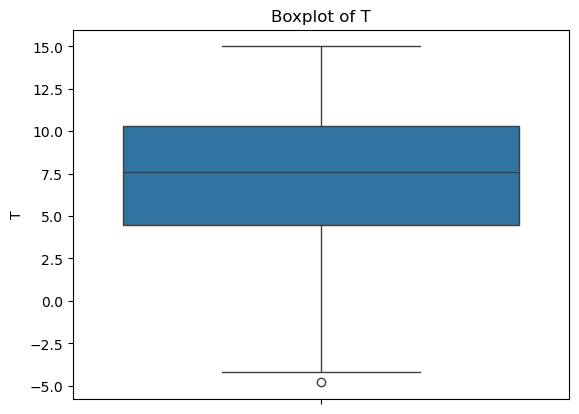

In [44]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


sns.boxplot(df_2023_station['T'])
plt.title('Boxplot of T')
plt.show()

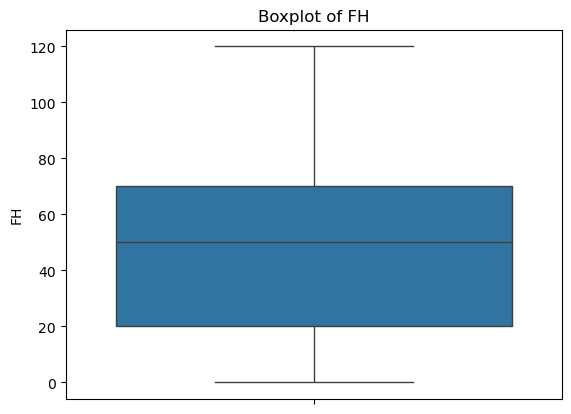

In [70]:
sns.boxplot(df_2023_station['FH'])
plt.title('Boxplot of FH')
plt.show()

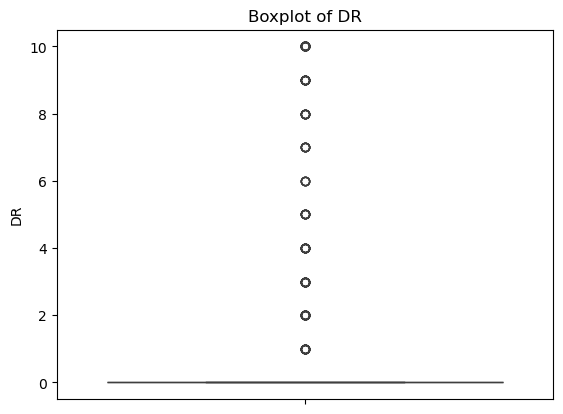

In [71]:
sns.boxplot(df_2023_station['DR'])
plt.title('Boxplot of DR')
plt.show()

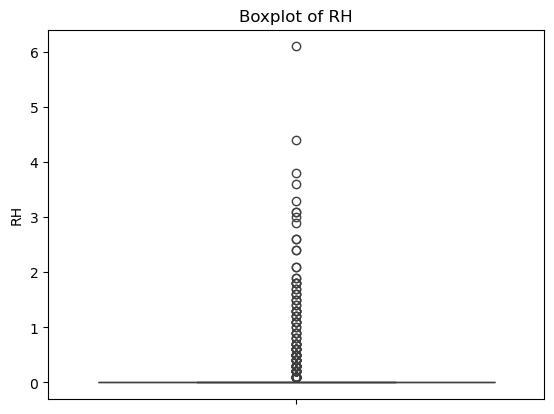

In [72]:
sns.boxplot(df_2023_station['RH'])
plt.title('Boxplot of RH')
plt.show()

In [45]:
# -1 values are all values that are 0.05 or less from measurements
df_2024.loc[df_2024["RH"] == -1, "RH"] = 0.05

# Format the temperature and rain properly
df_2024['T'] = df_2024['T'] * 0.1   # turn into C
df_2024['RH'] = df_2024['RH'] * 0.1  # turn into mm


# Format date
df_2024['date'] = pd.to_datetime(df_2024['date'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df_2024['day'] = df_2024['date'].dt.day
df_2024['month'] = df_2024['date'].dt.month
df_2024['year'] = df_2024['date'].dt.year

df_2024 = df_2024.drop('date', axis = 1)


# 2024 time period - Nov 4 - Dec 1
# Remove rows from month 11 with day < 6
df_2024 = df_2024[~((df_2024['month'] == 11) & (df_2024['day'] < 4))]

# Remove rows from month 12 with day > 3
df_2024 = df_2024[~((df_2024['month'] == 12) & (df_2024['day'] > 1))]

# Remove all rows from month 10
df_2024 = df_2024[df_2024['month'] != 10]

print(df_2024)


# Station mask
df_2024_station = df_2024[df_2024['station_code'] == station]

df_2024_station['day_id'] = df_2024_station.groupby(['month', 'day']).ngroup() + 1

# Groupby day and month and get the mean
daily_avr_2024_station = df_2024_station.groupby(['day_id']).agg({
    'FH': 'mean',
    'T': 'mean',
    'DR': 'mean',
    'RH': 'mean'
}).reset_index()

print(daily_avr_2024_station)

       station_code  hour    FH    T   DR   RH  day  month  year
168             209     1  50.0  NaN  NaN  NaN    4     11  2024
169             209     2  40.0  NaN  NaN  NaN    4     11  2024
170             209     3  40.0  NaN  NaN  NaN    4     11  2024
171             209     4  50.0  NaN  NaN  NaN    4     11  2024
172             209     5  60.0  NaN  NaN  NaN    4     11  2024
...             ...   ...   ...  ...  ...  ...  ...    ...   ...
39715           391    20  30.0  5.5  0.0  0.0    1     12  2024
39716           391    21  30.0  5.5  0.0  0.0    1     12  2024
39717           391    22  30.0  5.5  0.0  0.0    1     12  2024
39718           391    23  30.0  5.6  0.0  0.0    1     12  2024
39719           391    24  30.0  6.1  0.0  0.0    1     12  2024

[30912 rows x 9 columns]
    day_id         FH          T        DR        RH
0        1  25.833333   7.325000  0.000000  0.000000
1        2  16.250000   6.479167  0.000000  0.000000
2        3  12.916667   9.950000  0

C:\Users\gr02n\AppData\Local\Temp\ipykernel_15048\3149428054.py:36: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



# Tables

In [46]:
import plotly.express as px

temperature_2023 = px.line(daily_avr_2023_station, x = 'day_id', y = 'T', title = 'Temperature 2023') # , color = 'name'
temperature_2023.show()

rain_2023 = px.line(daily_avr_2023_station, x = 'day_id', y = 'RH', title = 'Rain 2023')
rain_2023.show()

temperature_2024 = px.line(daily_avr_2024_station, x = 'day_id', y = 'T', title = 'Temperature 2024')
temperature_2024.show()

rain_2024 = px.line(daily_avr_2024_station, x = 'day_id', y = 'RH', title = 'Rain 2024')
rain_2024.show()

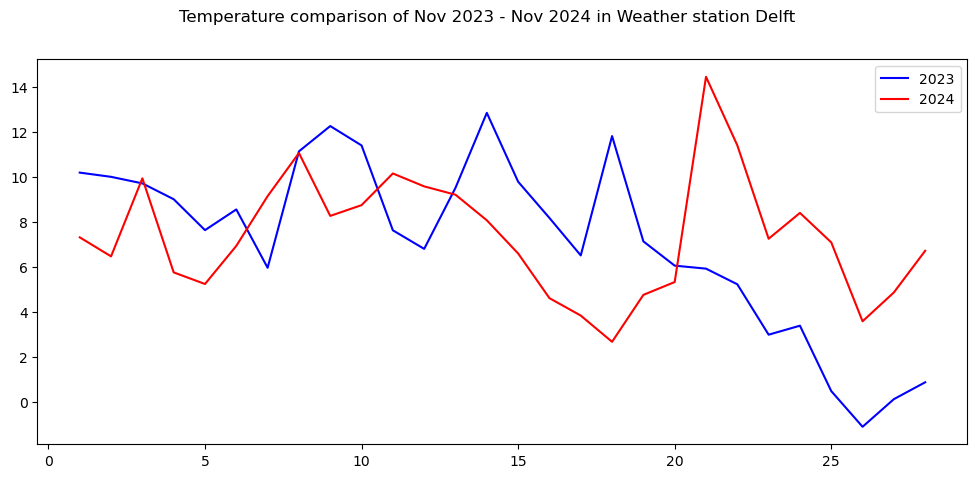

In [75]:
fig, ax_temp = plt.subplots(figsize=(12, 5))

l1, =ax_temp.plot(daily_avr_2023_station['day_id'], daily_avr_2023_station['T'], color = 'blue', label = '2023')
l2, =ax_temp.plot(daily_avr_2024_station['day_id'], daily_avr_2024_station['T'], color = 'red', label = '2023')

fig.suptitle(f'Temperature comparison of Nov 2023 - Nov 2024 in Weather station {station_name}')

ax_temp.legend([l1, l2], ['2023', '2024'])

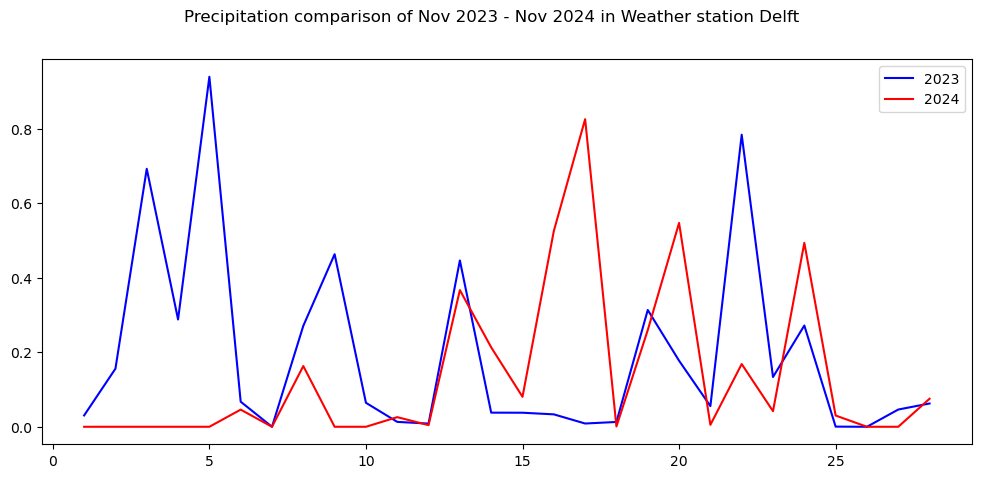

In [76]:
fig, ax_rain = plt.subplots(figsize=(12, 5))

l1, =ax_rain.plot(daily_avr_2023_station['day_id'], daily_avr_2023_station['RH'], color = 'blue', label = '2023')
l2, =ax_rain.plot(daily_avr_2024_station['day_id'], daily_avr_2024_station['RH'], color = 'red', label = '2023')

fig.suptitle(f'Precipitation comparison of Nov 2023 - Nov 2024 in Weather station {station_name}')

ax_rain.legend([l1, l2], ['2023', '2024'])

In [77]:
daily_avr_2023_station['year'] = 2023
daily_avr_2024_station['year'] = 2024

dfs = [daily_avr_2023_station, daily_avr_2024_station]
combined_df = pd.concat(dfs)

# combined_df

In [78]:
temperature_combined = px.line(combined_df, x = 'day_id', y = 'T', color = 'year', title = f'Temperature comparison of Nov 2023 - Nov 2024 in Weather station {station_name}',
                               labels={
                                "day_id": "Day of the chosen period",
                                "T": "Temperature"
                                })
temperature_combined.show()

rain_combined = px.line(combined_df, x = 'day_id', y = 'RH', color = 'year', title = f'Precipitation comparison of Nov 2023 - Nov 2024 in Weather station {station_name}',
                        labels={
                            "day_id": "Day of the chosen period",
                            "T": "Temperature"
                            })
rain_combined.show()

In [79]:
df_difference = pd.DataFrame()

df_difference['day_id'] = daily_avr_2023_station['day_id']
df_difference['T'] = daily_avr_2023_station['T'] - daily_avr_2024_station['T']
df_difference['RH'] = daily_avr_2023_station['RH'] - daily_avr_2024_station['RH']

# print(df_difference)

difference_T = px.line(df_difference, x = 'day_id', y = 'T', 
                       labels={
                            "day_id": "Day of the chosen period",
                            "T": "Temperature 2023 - 2024",
                            },
                       title = f'Temperature difference in November 2023-2024 for Weather station {station_name}') # , color = 'name'
difference_T.show()

difference_T = px.line(df_difference, x = 'day_id', y = 'RH', 
                       labels={
                            "day_id": "Day of the chosen period",
                            "RH": "Precipitation 2023 - 2024",
                            },
                       title = f'Precipitation difference in November 2023-2024 for Weather station {station_name}') # , color = 'name'
difference_T.show()


# OV-fiets

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import json
import plotly.express as px
import numpy as np

In [2]:
filename = r'C:\Users\gr02n\OneDrive\Desktop\OV-fiets data Nov 2023-2024\2023\OVFiets_2023-11-07.csv.xz'

df = pd.read_csv(filename,header = None)

# df

In [18]:
df["parsed"] = df[2].apply(json.loads)
# print(df['parsed'])

# Flatten into new columns
df2_flat = pd.json_normalize(df["parsed"])

# Combine back with your original DataFrame (optional)
df2_flat = pd.concat([df, df2_flat], axis=1)
df2_flat['extra.rentalBikes'] = df2_flat['extra.rentalBikes'].astype(float)
# df2_flat[0] = pd.to_datetime(df2_flat[0])
df2_flat[0] = pd.to_datetime(df2_flat[0], format="ISO8601", errors="coerce", utc=True)

# df2_flat = df2_flat.set_index(0)
df2_flat = df2_flat.rename(columns={0: "time"})


df2_flat['time'] = pd.to_datetime(df2_flat['time'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df2_flat['day'] = df2_flat['time'].dt.day
df2_flat['month'] = df2_flat['time'].dt.month
df2_flat['year'] = df2_flat['time'].dt.year
df2_flat['hour'] = df2_flat['time'].dt.hour
df2_flat['minute'] = df2_flat['time'].dt.minute

# df2_flat = df2_flat.drop_duplicates(subset=['month', 'day', 'hour', 'minute'])


In [20]:
# Dropping columns that are not relevant
df2_flat.drop(1, axis=1, inplace=True)
df2_flat.drop(2, axis=1, inplace=True)
df2_flat.drop(3, axis=1, inplace=True)

df2_flat.drop('link.uri', axis=1, inplace=True)
df2_flat.drop('thumbnail.uri', axis=1, inplace=True)
df2_flat.drop('extra.serviceType', axis=1, inplace=True)
# For E-bikes or ov-fiets (delft has only ov so it can be removed for now)
df2_flat.drop('extra.type', axis=1, inplace=True)

df2_flat.drop('extraInfo', axis=1, inplace=True)
df2_flat.drop('apps', axis=1, inplace=True)
df2_flat.drop('sites', axis=1, inplace=True)
df2_flat.drop('houseNumber', axis=1, inplace=True)
df2_flat.drop('street', axis=1, inplace=True)
df2_flat.drop('openingHours', axis=1, inplace=True)
df2_flat.drop('open', axis=1, inplace=True)
df2_flat.drop('ovFiets', axis=1, inplace=True)
df2_flat.drop('nearbyMeLocationId.type', axis=1, inplace=True)
df2_flat.drop('nearbyMeLocationId.value', axis=1, inplace=True)
df2_flat.drop('extra.locationCode', axis=1, inplace=True)
df2_flat.drop('name', axis=1, inplace=True)
df2_flat.drop('extra.fetchTime', axis=1, inplace=True)

# extra.serviceType
# extra.type

In [22]:
df2_flat['time_key'] = df2_flat['time'].dt.floor('min')
# df2_flat = df2_flat.drop_duplicates(subset='time_key', keep='first')
# df2_flat = df2_flat.drop(columns='time_key')
mask = (df2_flat['city'] == 'Delft') & (df2_flat['stationCode'] == "DT")
df2_flat[mask].head()

df_Delft = df2_flat[mask]

# df_Delft.keys()
# print(df_Delft.iloc[0, 15])


# List that is storing the duplicate rows
duplicates = []

previous_entry = None

# Looping through rows
for index, row in df_Delft.iterrows():
    current_entry = row['time_key']
    if current_entry == previous_entry:
        duplicates.append(True)
    else:
        duplicates.append(False)
        previous_entry = current_entry

df_Delft['duplicate'] = duplicates

df_Delft = df_Delft[~df_Delft['duplicate']]
# df_Delft.drop('duplicate', axis=1, inplace=True)


# Remove outliers
for i in range(1, len(df_Delft)):
    if df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] == 312:
        df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] = df_Delft.iloc[i - 1, df_Delft.columns.get_loc('extra.rentalBikes')]

# df_Delft[df_Delft['extra.rentalBikes'] == 312]


# df_Delft.drop('time_key', axis=1, inplace=True)
# df_Delft

C:\Users\gr02n\AppData\Local\Temp\ipykernel_15048\814708824.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


In [23]:
# df_Delft['time'] = df_Delft['time'].astype(str)
# df_Delft.to_excel('SixNovDelft.xlsx', index=False)

df_Delft

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,day,month,year,hour,minute,time_key,duplicate
121,2023-11-07 03:00:34+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,0,2023-11-07 03:00:00+00:00,False
405,2023-11-07 03:01:29+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,1,2023-11-07 03:01:00+00:00,False
689,2023-11-07 03:02:25+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,2,2023-11-07 03:02:00+00:00,False
973,2023-11-07 03:03:20+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,3,2023-11-07 03:03:00+00:00,False
1257,2023-11-07 03:04:15+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,4,2023-11-07 03:04:00+00:00,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
442025,2023-11-08 02:55:13+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,8,11,2023,2,55,2023-11-08 02:55:00+00:00,False
442309,2023-11-08 02:56:08+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,8,11,2023,2,56,2023-11-08 02:56:00+00:00,False
442593,2023-11-08 02:57:03+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,8,11,2023,2,57,2023-11-08 02:57:00+00:00,False
443161,2023-11-08 02:58:54+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,8,11,2023,2,58,2023-11-08 02:58:00+00:00,False


In [24]:
ovfiets_2023 = px.line(df_Delft, x = 'time', y = 'extra.rentalBikes', title = 'Supply of OV-Fiets 2023')
ovfiets_2023.show()

# Trying to combine files (1 week)

In [7]:
import os
import pyarrow as pa

In [2]:
def getDayData(df): 
    df["parsed"] = df[2].apply(json.loads)

    df2_flat = pd.json_normalize(df["parsed"])

    # Combine back with your original DataFrame (optional)
    df2_flat = pd.concat([df, df2_flat], axis=1)
    df2_flat['extra.rentalBikes'] = df2_flat['extra.rentalBikes'].astype(float)
    df2_flat[0] = pd.to_datetime(df2_flat[0], format="ISO8601", errors="coerce", utc=True)

    df2_flat = df2_flat.rename(columns={0: "time"})

    df2_flat['time'] = pd.to_datetime(df2_flat['time'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

    # extract the day, month, and year components
    df2_flat['day'] = df2_flat['time'].dt.day
    df2_flat['month'] = df2_flat['time'].dt.month
    df2_flat['year'] = df2_flat['time'].dt.year
    df2_flat['hour'] = df2_flat['time'].dt.hour
    df2_flat['minute'] = df2_flat['time'].dt.minute



    # Dropping columns that are not relevant
    df2_flat.drop(1, axis=1, inplace=True)
    df2_flat.drop(2, axis=1, inplace=True)
    df2_flat.drop(3, axis=1, inplace=True)

    df2_flat.drop('link.uri', axis=1, inplace=True)
    df2_flat.drop('thumbnail.uri', axis=1, inplace=True)
    df2_flat.drop('extra.serviceType', axis=1, inplace=True)
    # For E-bikes or ov-fiets (delft has only ov so it can be removed for now)
    df2_flat.drop('extra.type', axis=1, inplace=True)

    df2_flat.drop('extraInfo', axis=1, inplace=True)
    df2_flat.drop('apps', axis=1, inplace=True)
    df2_flat.drop('sites', axis=1, inplace=True)
    df2_flat.drop('houseNumber', axis=1, inplace=True)
    df2_flat.drop('street', axis=1, inplace=True)
    df2_flat.drop('openingHours', axis=1, inplace=True)
    df2_flat.drop('open', axis=1, inplace=True)
    df2_flat.drop('ovFiets', axis=1, inplace=True)
    df2_flat.drop('nearbyMeLocationId.type', axis=1, inplace=True)
    df2_flat.drop('nearbyMeLocationId.value', axis=1, inplace=True)
    df2_flat.drop('extra.locationCode', axis=1, inplace=True)
    df2_flat.drop('name', axis=1, inplace=True)
    df2_flat.drop('extra.fetchTime', axis=1, inplace=True)



    df2_flat['time_key'] = df2_flat['time'].dt.floor('min')
    # df2_flat = df2_flat.drop_duplicates(subset='time_key', keep='first')
    # df2_flat = df2_flat.drop(columns='time_key')
    mask = (df2_flat['city'] == 'Delft') & (df2_flat['stationCode'] == "DT")
    df2_flat[mask].head()

    df_Delft = df2_flat[mask]

    # List that is storing the duplicate rows
    duplicates = []

    previous_entry = None


    # Looping through rows
    for index, row in df_Delft.iterrows():
        current_entry = row['time_key']
        if current_entry == previous_entry:
            duplicates.append(True)
        else:
            duplicates.append(False)
            previous_entry = current_entry

    df_Delft['duplicate'] = duplicates

    df_Delft = df_Delft[~df_Delft['duplicate']]
    # df_Delft.drop('duplicate', axis=1, inplace=True)

    # Remove outliers
    for i in range(1, len(df_Delft)):
        if df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] == 312:
            df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] = df_Delft.iloc[i - 1, df_Delft.columns.get_loc('extra.rentalBikes')]

    # df_Delft.drop('time_key', axis=1, inplace=True)

    return df_Delft

In [3]:
# TESTING -> writing two dfs into the same one after reworking them
import os

folder_1 = r"C:\Users\gr02n\OneDrive\Desktop\OV-fiets data Nov 2023-2024\2023"
existing_table = pd.DataFrame()

name = "OVFiets_2023-11-07.csv.xz"

path = os.path.join(folder_1, name)
open_df = pd.read_csv(path, header = None)

print (f'Opened table -> {name}')

reworked_df = getDayData(open_df)

print (f'Table successfully reformated {name}')

existing_table = pd.concat([existing_table, reworked_df], ignore_index=True)

print (f'Table done and added => {name}')

name = "OVFiets_2023-11-08.csv.xz"

path = os.path.join(folder_1, name)
open_df = pd.read_csv(path, header = None)

print (f'Opened table -> {name}')

reworked_df = getDayData(open_df)

print (f'Table successfully reformated {name}')

existing_table = pd.concat([existing_table, reworked_df], ignore_index=True)

print (f'Table done and added => {name}')

existing_table.tail()

Opened table -> OVFiets_2023-11-07.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_5808\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2023-11-07.csv.xz
Table done and added => OVFiets_2023-11-07.csv.xz
Opened table -> OVFiets_2023-11-08.csv.xz
Table successfully reformated OVFiets_2023-11-08.csv.xz
Table done and added => OVFiets_2023-11-08.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_5808\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,day,month,year,hour,minute,time_key,duplicate
2875,2023-11-09 02:55:28+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,55,2023-11-09 02:55:00+00:00,False
2876,2023-11-09 02:56:24+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,56,2023-11-09 02:56:00+00:00,False
2877,2023-11-09 02:57:19+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,57,2023-11-09 02:57:00+00:00,False
2878,2023-11-09 02:58:14+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",223.0,9,11,2023,2,58,2023-11-09 02:58:00+00:00,False
2879,2023-11-09 02:59:10+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",223.0,9,11,2023,2,59,2023-11-09 02:59:00+00:00,False


In [ ]:
# ovfiets_2023 = px.line(existing_table, x = 'time', y = 'extra.rentalBikes', title = 'Supply of OV-Fiets 2023')
# ovfiets_2023.show()

# existing_table

In [3]:
import os

folder_1 = r"C:\Users\gr02n\OneDrive\Desktop\OV-fiets data Nov 2023-2024\2023"
existing_table = pd.DataFrame()

for name in os.listdir(folder_1):
    if name == "OVFiets_2023-11-10.csv":
        break
    
    path = os.path.join(folder_1, name)
    open_df = pd.read_csv(path, header = None)

    print (f'Opened table -> {name}')

    reworked_df = getDayData(open_df)

    print (f'Table successfully reformated {name}')

    existing_table = pd.concat([existing_table, reworked_df], ignore_index=True)

    print (f'Table done and added => {name}')

existing_table.tail()


Opened table -> OVFiets_2023-11-06.csv.xz


NameError: name 'getDayData' is not defined

In [38]:
ovfiets_2023 = px.line(existing_table, x = 'time', y = 'extra.rentalBikes', title = 'Supply of OV-Fiets 2023')
ovfiets_2023.show()

In [ ]:
existing_table['day_id'] = existing_table.groupby(['month', 'day']).ngroup() + 1

# existing_table.head()

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,day,month,year,hour,minute,time_key,duplicate,day_id
0,2023-11-06 03:00:12+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,6,11,2023,3,0,2023-11-06 03:00:00+00:00,False,1
1,2023-11-06 03:01:08+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,6,11,2023,3,1,2023-11-06 03:01:00+00:00,False,1
2,2023-11-06 03:02:03+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,6,11,2023,3,2,2023-11-06 03:02:00+00:00,False,1
3,2023-11-06 03:03:54+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,6,11,2023,3,3,2023-11-06 03:03:00+00:00,False,1
4,2023-11-06 03:04:49+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,6,11,2023,3,4,2023-11-06 03:04:00+00:00,False,1


In [51]:
daily_avr_2023_station['type'] = "weather"
existing_table['type'] = "bike"

df_2023_knmi_ov = [existing_table, daily_avr_2023_station]
combined_df = pd.concat(df_2023_knmi_ov)

combined_df.head()

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,...,hour,minute,time_key,duplicate,day_id,type,FH,T,DR,RH
0,2023-11-06 03:00:12+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,0.0,2023-11-06 03:00:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
1,2023-11-06 03:01:08+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,1.0,2023-11-06 03:01:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
2,2023-11-06 03:02:03+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,2.0,2023-11-06 03:02:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
3,2023-11-06 03:03:54+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,3.0,2023-11-06 03:03:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
4,2023-11-06 03:04:49+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,4.0,2023-11-06 03:04:00+00:00,False,1,bike,NaN,NaN,NaN,NaN


In [81]:
import plotly.express as px

ovfiets_2023 = px.line(combined_df, x = 'time', y = 'extra.rentalBikes', color = 'type' ,title = 'Supply of OV-Fiets 2023')
ovfiets_2023.show()

ovfiets_2023.write_image("Supply2023.png")
ovfiets_2023.write_image("Supply2023.jpeg")
ovfiets_2023.write_image("Supply2023.pdf")

ValueError: 
Image export using the "kaleido" engine requires the Kaleido package,
which can be installed using pip:

    $ pip install --upgrade kaleido


In [58]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=combined_df['time'],
    y=combined_df['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=combined_df['time'],
    y=combined_df['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and Temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()


In [74]:
combined_df[combined_df['T'] != np.nan]


,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,...,hour,minute,time_key,duplicate,day_id,type,FH,T,DR,RH
0,2023-11-06 03:00:12+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,0.0,2023-11-06 03:00:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
1,2023-11-06 03:01:08+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,1.0,2023-11-06 03:01:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
2,2023-11-06 03:02:03+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,2.0,2023-11-06 03:02:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
3,2023-11-06 03:03:54+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,3.0,2023-11-06 03:03:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
4,2023-11-06 03:04:49+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,3.0,4.0,2023-11-06 03:04:00+00:00,False,1,bike,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,24,weather,32.083333,3.395833,1.541667,0.271667
24,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,25,weather,15.416667,0.487500,0.000000,0.000417
25,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,26,weather,26.666667,-1.100000,0.000000,0.000000
26,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,27,weather,21.250000,0.129167,0.833333,0.046250


# Final script to run

Imports

In [2]:
import pandas as pd
import pyarrow as pa
import matplotlib.pyplot as plt
import seaborn as sns
import json
import plotly.express as px
import numpy as np
import os
import plotly.graph_objects as go

## Setup of OV-fiets

## To do 

Getting the amount of bikes rented out
- make an additional column that gets the difference between current entry and the previous entry
- add up all the negative values per day
- make that entry as the daily number of bikes rented put

Computatiion speed improvements
- Use drop_duplicate() methid instead of the loop for filtering out the duplicate rows

In [ ]:
"""
    Use drop_duplicate() methid instead of the loop for filtering out the duplicate rows
"""


def getDayData(df): 
    df["parsed"] = df[2].apply(json.loads)

    df2_flat = pd.json_normalize(df["parsed"])

    # Combine back with your original DataFrame (optional)
    df2_flat = pd.concat([df, df2_flat], axis=1)
    df2_flat['extra.rentalBikes'] = df2_flat['extra.rentalBikes'].astype(float)
    df2_flat[0] = pd.to_datetime(df2_flat[0], format="ISO8601", errors="coerce", utc=True)

    df2_flat = df2_flat.rename(columns={0: "time"})

    df2_flat['time'] = pd.to_datetime(df2_flat['time'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

    # extract the day, month, and year components
    df2_flat['day'] = df2_flat['time'].dt.day
    df2_flat['month'] = df2_flat['time'].dt.month
    df2_flat['year'] = df2_flat['time'].dt.year
    df2_flat['hour'] = df2_flat['time'].dt.hour
    df2_flat['minute'] = df2_flat['time'].dt.minute



    # Dropping columns that are not relevant
    df2_flat.drop(1, axis=1, inplace=True)
    df2_flat.drop(2, axis=1, inplace=True)
    df2_flat.drop(3, axis=1, inplace=True)

    df2_flat.drop('link.uri', axis=1, inplace=True)
    df2_flat.drop('thumbnail.uri', axis=1, inplace=True)
    df2_flat.drop('extra.serviceType', axis=1, inplace=True)
    # For E-bikes or ov-fiets (delft has only ov so it can be removed for now)
    df2_flat.drop('extra.type', axis=1, inplace=True)

    df2_flat.drop('extraInfo', axis=1, inplace=True)
    df2_flat.drop('apps', axis=1, inplace=True)
    df2_flat.drop('sites', axis=1, inplace=True)
    df2_flat.drop('houseNumber', axis=1, inplace=True)
    df2_flat.drop('street', axis=1, inplace=True)
    df2_flat.drop('openingHours', axis=1, inplace=True)
    df2_flat.drop('open', axis=1, inplace=True)
    df2_flat.drop('ovFiets', axis=1, inplace=True)
    df2_flat.drop('nearbyMeLocationId.type', axis=1, inplace=True)
    df2_flat.drop('nearbyMeLocationId.value', axis=1, inplace=True)
    df2_flat.drop('extra.locationCode', axis=1, inplace=True)
    df2_flat.drop('name', axis=1, inplace=True)
    df2_flat.drop('extra.fetchTime', axis=1, inplace=True)



    df2_flat['time_key'] = df2_flat['time'].dt.floor('min')
    # df2_flat = df2_flat.drop_duplicates(subset='time_key', keep='first')
    # df2_flat = df2_flat.drop(columns='time_key')
    mask = (df2_flat['city'] == 'Delft') & (df2_flat['stationCode'] == "DT")
    df2_flat[mask].head()

    df_Delft = df2_flat[mask]

    # List that is storing the duplicate rows
    duplicates = []

    previous_entry = None

    # Looping through rows 
    for index, row in df_Delft.iterrows():
        current_entry = row['time_key']
        if current_entry == previous_entry:
            duplicates.append(True)
        else:
            duplicates.append(False)
            previous_entry = current_entry

    df_Delft['duplicate'] = duplicates

    df_Delft = df_Delft[~df_Delft['duplicate']]
    # df_Delft.drop('duplicate', axis=1, inplace=True)

    # Remove outliers
    for i in range(1, len(df_Delft)):
        if df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] == 312:
            df_Delft.iloc[i, df_Delft.columns.get_loc('extra.rentalBikes')] = df_Delft.iloc[i - 1, df_Delft.columns.get_loc('extra.rentalBikes')]

    # df_Delft.drop('time_key', axis=1, inplace=True)

    return df_Delft




IndentationError: unexpected indent (1487194204.py, line 70)

In [ ]:
folder_1 = r"C:\Users\gr02n\OneDrive\Desktop\OV-fiets data Nov 2023-2024\2023"
existing_table_2023 = pd.DataFrame()

# Get 2023 data
for name in os.listdir(folder_1):
    # if name == "OVFiets_2023-11-10.csv":
    #     break
    
    path = os.path.join(folder_1, name)
    open_df = pd.read_csv(path, header = None)

    print (f'Opened table -> {name}')

    reworked_df = getDayData(open_df)

    print (f'Table successfully reformated {name}')

    existing_table_2023 = pd.concat([existing_table_2023, reworked_df], ignore_index=True)

    print (f'Table done and added => {name}')


NameError: name 'os' is not defined

In [3]:
folder_2 = r"C:\Users\gr02n\OneDrive\Desktop\OV-fiets data Nov 2023-2024\2024"
existing_table_2024 = pd.DataFrame()

# Get 2024 data
for name in os.listdir(folder_2):
    # if name == "OVFiets_2023-11-10.csv":
    #     break
    
    path = os.path.join(folder_2, name)
    open_df = pd.read_csv(path, header = None)

    print (f'Opened table -> {name}')

    reworked_df = getDayData(open_df)

    print (f'Table successfully reformated {name}')

    existing_table_2024 = pd.concat([existing_table_2024, reworked_df], ignore_index=True)

    print (f'Table done and added => {name}')

Opened table -> OVFiets_2024-11-04.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-04.csv.xz
Table done and added => OVFiets_2024-11-04.csv.xz
Opened table -> OVFiets_2024-11-05.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-05.csv.xz
Table done and added => OVFiets_2024-11-05.csv.xz
Opened table -> OVFiets_2024-11-06.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-06.csv.xz
Table done and added => OVFiets_2024-11-06.csv.xz
Opened table -> OVFiets_2024-11-07.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-07.csv.xz
Table done and added => OVFiets_2024-11-07.csv.xz
Opened table -> OVFiets_2024-11-08.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-08.csv.xz
Table done and added => OVFiets_2024-11-08.csv.xz
Opened table -> OVFiets_2024-11-09.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-09.csv.xz
Table done and added => OVFiets_2024-11-09.csv.xz
Opened table -> OVFiets_2024-11-10.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-10.csv.xz
Table done and added => OVFiets_2024-11-10.csv.xz
Opened table -> OVFiets_2024-11-11.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-11.csv.xz
Table done and added => OVFiets_2024-11-11.csv.xz
Opened table -> OVFiets_2024-11-12.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-12.csv.xz
Table done and added => OVFiets_2024-11-12.csv.xz
Opened table -> OVFiets_2024-11-13.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-13.csv.xz
Table done and added => OVFiets_2024-11-13.csv.xz
Opened table -> OVFiets_2024-11-14.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-14.csv.xz
Table done and added => OVFiets_2024-11-14.csv.xz
Opened table -> OVFiets_2024-11-15.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-15.csv.xz
Table done and added => OVFiets_2024-11-15.csv.xz
Opened table -> OVFiets_2024-11-16.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-16.csv.xz
Table done and added => OVFiets_2024-11-16.csv.xz
Opened table -> OVFiets_2024-11-17.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-17.csv.xz
Table done and added => OVFiets_2024-11-17.csv.xz
Opened table -> OVFiets_2024-11-18.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-18.csv.xz
Table done and added => OVFiets_2024-11-18.csv.xz
Opened table -> OVFiets_2024-11-19.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-19.csv.xz
Table done and added => OVFiets_2024-11-19.csv.xz
Opened table -> OVFiets_2024-11-20.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-20.csv.xz
Table done and added => OVFiets_2024-11-20.csv.xz
Opened table -> OVFiets_2024-11-21.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-21.csv.xz
Table done and added => OVFiets_2024-11-21.csv.xz
Opened table -> OVFiets_2024-11-22.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-22.csv.xz
Table done and added => OVFiets_2024-11-22.csv.xz
Opened table -> OVFiets_2024-11-23.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-23.csv.xz
Table done and added => OVFiets_2024-11-23.csv.xz
Opened table -> OVFiets_2024-11-24.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-24.csv.xz
Table done and added => OVFiets_2024-11-24.csv.xz
Opened table -> OVFiets_2024-11-25.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-25.csv.xz
Table done and added => OVFiets_2024-11-25.csv.xz
Opened table -> OVFiets_2024-11-26.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-26.csv.xz
Table done and added => OVFiets_2024-11-26.csv.xz
Opened table -> OVFiets_2024-11-27.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-27.csv.xz
Table done and added => OVFiets_2024-11-27.csv.xz
Opened table -> OVFiets_2024-11-28.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-28.csv.xz
Table done and added => OVFiets_2024-11-28.csv.xz
Opened table -> OVFiets_2024-11-29.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-29.csv.xz
Table done and added => OVFiets_2024-11-29.csv.xz
Opened table -> OVFiets_2024-11-30.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


Table successfully reformated OVFiets_2024-11-30.csv.xz
Table done and added => OVFiets_2024-11-30.csv.xz
Opened table -> OVFiets_2024-12-01.csv.xz
Table successfully reformated OVFiets_2024-12-01.csv.xz
Table done and added => OVFiets_2024-12-01.csv.xz


C:\Users\gr02n\AppData\Local\Temp\ipykernel_27516\1632547053.py:74: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_Delft['duplicate'] = duplicates


## Setup of KNMI data

In [4]:
# Files is still not in the branch
path_2023 = r'C:\Users\gr02n\OneDrive\Desktop\KNMI data - Manasa\KNMI-2023.json'
path_2024 = r'C:\Users\gr02n\OneDrive\Desktop\KNMI data - Manasa\KNMI-2024.json'

with open(path_2023, 'r') as file:
    raw_2023 = json.load(file)

with open(path_2024, 'r') as file:
    raw_2024 = json.load(file)

df_2023 = pd.DataFrame(raw_2023)
df_2024 = pd.DataFrame(raw_2024)

# FH    - Hourly average wind speed (in 0.1 m/s)
# T     - Temperature (in 0.1 degrees Celsius) at 1.50 m altitude during the observation
# DR    - Duration of precipitation (in 0.1 hour) per hourly section
# RH    - Hourly Sum of Precipitation (in 0.1 mm) (-1 for <0.05 mm)

station = 344
station_name = 'Delft'

In [5]:
df_2023.loc[df_2023["RH"] == -1, "RH"] = 0.05

df_2023['T'] = df_2023['T'] * 0.1   # turn into C
df_2023['RH'] = df_2023['RH'] * 0.1  # turn into mm

# Format date
df_2023['date'] = pd.to_datetime(df_2023['date'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df_2023['day'] = df_2023['date'].dt.day
df_2023['month'] = df_2023['date'].dt.month
df_2023['year'] = df_2023['date'].dt.year

df_2023 = df_2023.drop('date', axis = 1)


# 2023 time period - Nov 6 - Dec 3
# Remove rows from month 11 with day < 6
df_2023 = df_2023[~((df_2023['month'] == 11) & (df_2023['day'] < 6))]

# Remove rows from month 12 with day > 3
df_2023 = df_2023[~((df_2023['month'] == 12) & (df_2023['day'] > 3))]

# Remove all rows from month 10
df_2023 = df_2023[df_2023['month'] != 10]



df_2023_station = df_2023[df_2023['station_code'] == station]
df_2023_station.reset_index()

# Assign a unique number to each (day, month) pair
df_2023_station['day_id'] = df_2023_station.groupby(['month', 'day']).ngroup() + 1

# daily_avr_2023_station = df_2023_station.groupby(['day_id']).agg({
#     'FH': 'mean',
#     'T': 'mean',
#     'DR': 'mean',
#     'RH': 'mean'
# }).reset_index()

C:\Users\gr02n\AppData\Local\Temp\ipykernel_21192\889550843.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['day_id'] = df_2023_station.groupby(['month', 'day']).ngroup() + 1


In [6]:
# -1 values are all values that are 0.05 or less from measurements
df_2024.loc[df_2024["RH"] == -1, "RH"] = 0.05

# Format the temperature and rain properly
df_2024['T'] = df_2024['T'] * 0.1   # turn into C
df_2024['RH'] = df_2024['RH'] * 0.1  # turn into mm


# Format date
df_2024['date'] = pd.to_datetime(df_2024['date'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df_2024['day'] = df_2024['date'].dt.day
df_2024['month'] = df_2024['date'].dt.month
df_2024['year'] = df_2024['date'].dt.year

df_2024 = df_2024.drop('date', axis = 1)


# 2024 time period - Nov 4 - Dec 1
# Remove rows from month 11 with day < 6
df_2024 = df_2024[~((df_2024['month'] == 11) & (df_2024['day'] < 4))]

# Remove rows from month 12 with day > 3
df_2024 = df_2024[~((df_2024['month'] == 12) & (df_2024['day'] > 1))]

# Remove all rows from month 10
df_2024 = df_2024[df_2024['month'] != 10]


# Station mask
df_2024_station = df_2024[df_2024['station_code'] == station]

df_2024_station['day_id'] = df_2024_station.groupby(['month', 'day']).ngroup() + 1

# Groupby day and month and get the mean
# daily_avr_2024_station = df_2024_station.groupby(['day_id']).agg({
#     'FH': 'mean',
#     'T': 'mean',
#     'DR': 'mean',
#     'RH': 'mean'
# }).reset_index()

# print(daily_avr_2024_station)

KeyError: 'date'

## Combinihg both

In [6]:
counter = 0
y = 0

for i in range(len(existing_table_2023)):
    existing_table_2023.at[i, 'T'] = df_2023_station.iloc[y]['T']
    existing_table_2023.at[i, 'RH'] = df_2023_station.iloc[y]['RH']
    existing_table_2023.at[i, 'FH'] = df_2023_station.iloc[y]['FH']
    existing_table_2023.at[i, 'DR'] = df_2023_station.iloc[y]['DR']
    counter += 1
    if counter == 60:
        y += 1
        counter = 0

In [7]:
counter = 0
y = 0

for i in range(len(existing_table_2024)):
    existing_table_2024.at[i, 'T'] = df_2024_station.iloc[y]['T']
    existing_table_2024.at[i, 'RH'] = df_2024_station.iloc[y]['RH']
    existing_table_2024.at[i, 'FH'] = df_2024_station.iloc[y]['FH']
    existing_table_2024.at[i, 'DR'] = df_2024_station.iloc[y]['DR']
    counter += 1
    if counter == 60:
        y += 1
        counter = 0

In [ ]:
# Saving to excel?
existing_table_2023.to_json('knmi-ov-2023.json', orient='records', lines=True)

In [8]:
existing_table_2024.to_json('knmi-ov-2024.json', orient='records', lines=True)

# Plotting -> Run

In [7]:
import pandas as pd
import pyarrow as pa
import matplotlib.pyplot as plt
import seaborn as sns
import json
import plotly.express as px
import numpy as np
import os
import plotly.graph_objects as go
from datetime import datetime
import plotly.io as pio

In [2]:
existing_table_2023 = pd.read_json('knmi-ov-2023.json', orient='records', lines=True)

counter = 0

for i in range(len(existing_table_2023)):
    existing_table_2023['time'][counter] = datetime.fromtimestamp(int(existing_table_2023['time'][counter]/1000))
    counter += 1

# existing_table_2023

# existing_table_2023.head()

C:\Users\gr02n\AppData\Local\Temp\ipykernel_19296\696667807.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  existing_table_2023['time'][counter] = datetime.fromtimestamp(int(existing_table_2023['time'][counter]/1000))
C:\Users\gr02n\AppD

In [3]:
existing_table_2024 = pd.read_json('knmi-ov-2024.json', orient='records', lines=True)

counter = 0

for i in range(len(existing_table_2024)):
    existing_table_2024['time'][counter] = datetime.fromtimestamp(int(existing_table_2024['time'][counter]/1000))
    counter += 1

C:\Users\gr02n\AppData\Local\Temp\ipykernel_19296\418655272.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  existing_table_2024['time'][counter] = datetime.fromtimestamp(int(existing_table_2024['time'][counter]/1000))
C:\Users\gr02n\AppD

In [4]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()


# fig.write_image("2023-T.png")  # or "my_plot.jpeg", "my_plot.pdf"



In [ ]:
# Save as JPEG
fig.write_image("OVfiets_T_2023.pdf", format="pdf")

In [8]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['RH'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and precipitation in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Precipitation (mm)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()

fig.write_image("OVfiets_Rain_2023.pdf", format="pdf")


In [9]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2024['time'],
    y=existing_table_2024['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2024['time'],
    y=existing_table_2024['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and temperature in 2024',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()

fig.write_image("OVfiets_T_2024.pdf", format="pdf")


In [10]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2024['time'],
    y=existing_table_2024['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2024['time'],
    y=existing_table_2024['RH'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and precipitation in 2024',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Precipitation (mm)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()

fig.write_image("OVfiets_Rain_2024.pdf", format="pdf")


# Combining t with precipitation

In [1]:
import pandas as pd
import pyarrow as pa
import matplotlib.pyplot as plt
import seaborn as sns
import json
import plotly.express as px
import numpy as np
import os
import plotly.graph_objects as go
from datetime import datetime
import plotly.io as pio

## Editing dataframe

In [2]:
existing_table_2023 = pd.read_json('knmi-ov-2023.json', orient='records', lines=True)

counter = 0

for i in range(len(existing_table_2023)):
    existing_table_2023['time'][counter] = datetime.fromtimestamp(int(existing_table_2023['time'][counter]/1000))
    counter += 1

C:\Users\gr02n\AppData\Local\Temp\ipykernel_27540\3459896545.py:6: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  existing_table_2023['time'][counter] = datetime.fromtimestamp(int(existing_table_2023['time'][counter]/1000))
C:\Users\gr02n\App

In [ ]:
existing_table_2024 = pd.read_json('knmi-ov-2024.json', orient='records', lines=True)

counter = 0

for i in range(len(existing_table_2024)):
    existing_table_2024['time'][counter] = datetime.fromtimestamp(int(existing_table_2024['time'][counter]/1000))
    counter += 1

In [4]:
existing_table_2023.head()

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,...,month,year,hour,minute,time_key,duplicate,T,RH,FH,DR
0,2023-11-06 04:00:12,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,11,2023,3,0,1699239600000,False,10.0,0.2,70,2
1,2023-11-06 04:01:08,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,11,2023,3,1,1699239660000,False,10.0,0.2,70,2
2,2023-11-06 04:02:03,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,11,2023,3,2,1699239720000,False,10.0,0.2,70,2
3,2023-11-06 04:03:54,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,11,2023,3,3,1699239780000,False,10.0,0.2,70,2
4,2023-11-06 04:04:49,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",245.0,...,11,2023,3,4,1699239840000,False,10.0,0.2,70,2


In [5]:
existing_table_2023.keys()

Index(['time', 'parsed', 'infoImages', 'city', 'postalCode', 'lat',
       'stationCode', 'lng', 'description', 'extra.rentalBikes', 'day',
       'month', 'year', 'hour', 'minute', 'time_key', 'duplicate', 'T', 'RH',
       'FH', 'DR'],
      dtype='object')

In [18]:
# Convert to available supply
existing_table_2023["supply"] = 312 - existing_table_2023["extra.rentalBikes"]

# Universal code (needs to download data and LEAVE the outliers in)
# existing_table_2023["supply"] = existing_table_2023["extra.rentalBikes"].max() - existing_table_2023["extra.rentalBikes"]

# existing_table_2023["supply"]

In [19]:
# existing_table_2023["extra.rentalBikes"]

In [21]:
existing_table_2023["T_RH_combined"] = existing_table_2023["T"] - existing_table_2023["RH"]

existing_table_2023["T_RH_combined"]

0        9.8
1        9.8
2        9.8
3        9.8
4        9.8
        ... 
40308    1.4
40309    1.4
40310    1.4
40311    1.4
40312    1.4
Name: T_RH_combined, Length: 40313, dtype: float64

In [ ]:
weekly_supply = {}
amount_of_bikes_counter = 0 

for i in existing_table_2023["supply"]: 
    # if 

## Plotting

In [10]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['supply'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()


# fig.write_image("2023-T.png")  # or "my_plot.jpeg", "my_plot.pdf"



In [27]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['supply'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['T_RH_combined'],
    mode='lines',
    name='T_RH',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='T-RH product', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()


# fig.write_image("2023-T.png")  # or "my_plot.jpeg", "my_plot.pdf"



# testing 

In [22]:
existing_table.head()

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,day,month,year,hour,minute,time_key,duplicate,type
0,2023-11-07 03:00:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,0,2023-11-07 03:00:00+00:00,False,bike
1,2023-11-07 03:01:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,1,2023-11-07 03:01:00+00:00,False,bike
2,2023-11-07 03:02:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,2,2023-11-07 03:02:00+00:00,False,bike
3,2023-11-07 03:03:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,3,2023-11-07 03:03:00+00:00,False,bike
4,2023-11-07 03:04:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,4,2023-11-07 03:04:00+00:00,False,bike


In [23]:
df_2023.loc[df_2023["RH"] == -1, "RH"] = 0.05

df_2023['T'] = df_2023['T'] * 0.1   # turn into C
df_2023['RH'] = df_2023['RH'] * 0.1  # turn into mm

# Format date
df_2023['date'] = pd.to_datetime(df_2023['date'], format = "%Y-%m-%dT%H:%M:%S.%fZ")

# extract the day, month, and year components
df_2023['day'] = df_2023['date'].dt.day
df_2023['month'] = df_2023['date'].dt.month
df_2023['year'] = df_2023['date'].dt.year

# df_2023 = df_2023.drop('date', axis = 1)


# 2023 time period - Nov 6 - Dec 3
# Remove rows from month 11 with day < 6
df_2023 = df_2023[~((df_2023['month'] == 11) & (df_2023['day'] < 6))]

# Remove rows from month 12 with day > 3
df_2023 = df_2023[~((df_2023['month'] == 12) & (df_2023['day'] > 3))]

# Remove all rows from month 10
df_2023 = df_2023[df_2023['month'] != 10]



df_2023_station = df_2023[df_2023['station_code'] == station]
df_2023_station.reset_index()

,index,station_code,date,hour,FH,T,DR,RH,day,month,year
0,32136,344,2023-11-06,1,70.0,10.0,2.0,0.200,6,11,2023
1,32137,344,2023-11-06,2,70.0,9.9,0.0,0.005,6,11,2023
2,32138,344,2023-11-06,3,70.0,9.7,0.0,0.000,6,11,2023
3,32139,344,2023-11-06,4,70.0,9.7,0.0,0.000,6,11,2023
4,32140,344,2023-11-06,5,80.0,9.6,0.0,0.000,6,11,2023
...,...,...,...,...,...,...,...,...,...,...,...
667,32803,344,2023-12-03,20,60.0,0.7,10.0,0.400,3,12,2023
668,32804,344,2023-12-03,21,60.0,1.1,7.0,0.300,3,12,2023
669,32805,344,2023-12-03,22,60.0,1.2,0.0,0.000,3,12,2023
670,32806,344,2023-12-03,23,60.0,1.6,0.0,0.000,3,12,2023


In [ ]:
df_2023_station

,station_code,date,hour,FH,T,DR,RH,day,month,year
168,209,2023-11-06,1,90.0,NaN,NaN,NaN,6,11,2023
169,209,2023-11-06,2,100.0,NaN,NaN,NaN,6,11,2023
170,209,2023-11-06,3,110.0,NaN,NaN,NaN,6,11,2023
171,209,2023-11-06,4,100.0,NaN,NaN,NaN,6,11,2023
172,209,2023-11-06,5,90.0,NaN,NaN,NaN,6,11,2023
...,...,...,...,...,...,...,...,...,...,...
39715,391,2023-12-03,20,40.0,0.0,10.0,1.000,3,12,2023
39716,391,2023-12-03,21,30.0,0.0,10.0,0.700,3,12,2023
39717,391,2023-12-03,22,30.0,-0.2,10.0,0.100,3,12,2023
39718,391,2023-12-03,23,30.0,-0.4,0.0,0.005,3,12,2023


In [56]:
df_2023_station['datetime_str'] = df_2023_station['date'].astype(str) + ' ' + df_2023_station['hour'].astype(str).str.zfill(2) + ':00'

# df_2023_station

C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\4017641737.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['datetime_str'] = df_2023_station['date'].astype(str) + ' ' + df_2023_station['hour'].astype(str).str.zfill(2) + ':00'


In [73]:
import pandas as pd

# Make sure 'date' and 'hour' are strings and integers
df_2023_station['date'] = df_2023_station['date'].astype(str)
df_2023_station['hour'] = df_2023_station['hour'].astype(int)

df_2023_station

# existing_table['time'][2]

counter = 0
y = 0

for i in range(len(existing_table)):
    existing_table.at[i, 'T'] = df_2023_station.iloc[y]['T']
    existing_table.at[i, 'RH'] = df_2023_station.iloc[y]['RH']
    existing_table.at[i, 'FH'] = df_2023_station.iloc[y]['FH']
    existing_table.at[i, 'DR'] = df_2023_station.iloc[y]['DR']
    counter += 1
    if counter == 60:
        y += 1
        counter = 0

existing_table

#     pass

C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\417991897.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['date'] = df_2023_station['date'].astype(str)
C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\417991897.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['hour'] = df_2023_station['hour'].astype(int)


,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,...,hour,minute,time_key,duplicate,type,key,T,RH,FH,DR
0,2023-11-07 03:00:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,0,2023-11-07 03:00:00+00:00,False,bike,07-11-23 03,10.0,0.200,70.0,2.0
1,2023-11-07 03:01:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,1,2023-11-07 03:01:00+00:00,False,bike,07-11-23 03,10.0,0.200,70.0,2.0
2,2023-11-07 03:02:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,2,2023-11-07 03:02:00+00:00,False,bike,07-11-23 03,10.0,0.200,70.0,2.0
3,2023-11-07 03:03:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,3,2023-11-07 03:03:00+00:00,False,bike,07-11-23 03,10.0,0.200,70.0,2.0
4,2023-11-07 03:04:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,4,2023-11-07 03:04:00+00:00,False,bike,07-11-23 03,10.0,0.200,70.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2875,2023-11-09 02:55:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,...,2,55,2023-11-09 02:55:00+00:00,False,bike,09-11-23 02,9.6,0.005,60.0,0.0
2876,2023-11-09 02:56:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,...,2,56,2023-11-09 02:56:00+00:00,False,bike,09-11-23 02,9.6,0.005,60.0,0.0
2877,2023-11-09 02:57:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,...,2,57,2023-11-09 02:57:00+00:00,False,bike,09-11-23 02,9.6,0.005,60.0,0.0
2878,2023-11-09 02:58:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",223.0,...,2,58,2023-11-09 02:58:00+00:00,False,bike,09-11-23 02,9.6,0.005,60.0,0.0


In [ ]:
# existing_table['time_key']

df_2023_station['datetime_str'] = df_2023_station['date'].astype(str) + ' ' + df_2023_station['hour'].astype(str).str.zfill(2) + ':00'


existing_table['key'] = pd.to_datetime(existing_table['key'])  # ensure it's datetime
existing_table['key'] = existing_table['time_key'].dt.strftime('%Y-%m-%d %H') + ':00'

# existing_table['key']

df_new = existing_table.merge(df_2023_station[['key', 'T']], on='key', how='left')

df_new

,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,day,month,year,hour,minute,time_key,duplicate,type,key,T
0,2023-11-07 03:00:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,0,2023-11-07 03:00:00+00:00,False,bike,2023-11-07 03:00,NaN
1,2023-11-07 03:01:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,1,2023-11-07 03:01:00+00:00,False,bike,2023-11-07 03:00,NaN
2,2023-11-07 03:02:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,2,2023-11-07 03:02:00+00:00,False,bike,2023-11-07 03:00,NaN
3,2023-11-07 03:03:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,3,2023-11-07 03:03:00+00:00,False,bike,2023-11-07 03:00,NaN
4,2023-11-07 03:04:00+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,7,11,2023,3,4,2023-11-07 03:04:00+00:00,False,bike,2023-11-07 03:00,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2875,2023-11-09 02:55:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,55,2023-11-09 02:55:00+00:00,False,bike,2023-11-09 02:00,NaN
2876,2023-11-09 02:56:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,56,2023-11-09 02:56:00+00:00,False,bike,2023-11-09 02:00,NaN
2877,2023-11-09 02:57:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",224.0,9,11,2023,2,57,2023-11-09 02:57:00+00:00,False,bike,2023-11-09 02:00,NaN
2878,2023-11-09 02:58:00+00:00,{'infoImages': [{'body': 'Je huurt hier een OV...,[{'body': 'Je huurt hier een OV-fiets met het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",223.0,9,11,2023,2,58,2023-11-09 02:58:00+00:00,False,bike,2023-11-09 02:00,NaN


In [ ]:
existing_table['time'] = pd.to_datetime(existing_table['time_key'])

df_2023_station['datetime_str'] = df_2023_station['date'].astype(str) + ' ' + df_2023_station['hour'].astype(str).str.zfill(2) + ':00'
df_2023_station['datetime_str'] = pd.to_datetime(df_2023_station['date'])

existing_table['key'] = existing_table['time'].dt.strftime('%Y-%m-%d %H')
df_2023_station['key'] = df_2023_station['date'].dt.strftime('%Y-%m-%d %H')

df_new = existing_table.merge(df_2023_station[['key', 'T']], on='key', how='left')

# df_new
# existing_table['key']
# df_2023_station['key']


C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\2438879527.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['datetime_str'] = df_2023_station['date'].astype(str) + ' ' + df_2023_station['hour'].astype(str).str.zfill(2) + ':00'
C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\2438879527.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['datetime_str'] = pd.to_datetime(df_2023_station['date'])
C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\2438879527.py:7: SettingWit

0       2023-11-07 03
1       2023-11-07 03
2       2023-11-07 03
3       2023-11-07 03
4       2023-11-07 03
            ...      
2875    2023-11-09 02
2876    2023-11-09 02
2877    2023-11-09 02
2878    2023-11-09 02
2879    2023-11-09 02
Name: key, Length: 2880, dtype: object

In [17]:
df_2023_station['type'] = "weather"
existing_table['type'] = "bike"

df_2023_knmi_ov = [existing_table, df_2023_station]
combined_df = pd.concat(df_2023_knmi_ov)

combined_df

C:\Users\gr02n\AppData\Local\Temp\ipykernel_28808\3921414225.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2023_station['type'] = "weather"


,time,parsed,infoImages,city,postalCode,lat,stationCode,lng,description,extra.rentalBikes,...,hour,minute,time_key,duplicate,type,station_code,FH,T,DR,RH
0,2023-11-07 03:00:34+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,0.0,2023-11-07 03:00:00+00:00,False,bike,NaN,NaN,NaN,NaN,NaN
1,2023-11-07 03:01:29+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,1.0,2023-11-07 03:01:00+00:00,False,bike,NaN,NaN,NaN,NaN,NaN
2,2023-11-07 03:02:25+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,2.0,2023-11-07 03:02:00+00:00,False,bike,NaN,NaN,NaN,NaN,NaN
3,2023-11-07 03:03:20+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,3.0,2023-11-07 03:03:00+00:00,False,bike,NaN,NaN,NaN,NaN,NaN
4,2023-11-07 03:04:15+00:00,{'infoImages': [{'body': 'U vindt de fietsenst...,[{'body': 'U vindt de fietsenstalling aan het ...,Delft,2611 BV,52.006473,DT,4.35744,"Delft, Fietsenstalling",268.0,...,3,4.0,2023-11-07 03:04:00+00:00,False,bike,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32803,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,20,NaN,NaT,NaN,weather,344.0,60.0,0.7,10.0,0.4
32804,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,21,NaN,NaT,NaN,weather,344.0,60.0,1.1,7.0,0.3
32805,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,22,NaN,NaT,NaN,weather,344.0,60.0,1.2,0.0,0.0
32806,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,23,NaN,NaT,NaN,weather,344.0,60.0,1.6,0.0,0.0


In [74]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table['time'],
    y=existing_table['extra.rentalBikes'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table['time'],
    y=existing_table['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and Temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()


In [13]:
import plotly.graph_objects as go

fig = go.Figure()

# Left y-axis: extra.rentalBikes
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['supply'],
    mode='lines',
    name='Rental Bikes',
    line=dict(color='blue')
))

# Right y-axis: Temperature
fig.add_trace(go.Scatter(
    x=existing_table_2023['time'],
    y=existing_table_2023['T'],
    mode='lines',
    name='Temperature',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout with dual y-axes
fig.update_layout(
    title='OV-Fiets Supply and Temperature in 2023',
    xaxis=dict(title='Time'),
    yaxis=dict(
        title=dict(text='Rental Bikes', font=dict(color='blue')),
        tickfont=dict(color='blue')
    ),
    yaxis2=dict(
        title=dict(text='Temperature (°C)', font=dict(color='red')),
        tickfont=dict(color='red'),
        overlaying='y',
        side='right',
        anchor='x'
    ),
    legend=dict(x=0.01, y=0.99)
)

# px.line(combined_df, x='time', y='T', title='Temperature Over Time').show()

fig.show()
